# WGAN

## Imports

In [15]:
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torch.autograd import Variable
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML

In [1]:
# Set the hyperparameters
batchSize = 128 # try 64, 128, 256
imageSize = 64 # (64 x 64) 

beta1 = 0.5 # beta1 hyperparameter for Adam optimizers
lr = 0.00005 # learning rate

label_smoothing = 0.1 # best value: 0.3

epochs = 50

nz = 200 # size of the z latent vector (size of generator input) usually 100

clip_value = 0.01 # clipping parameter for the weights of the discriminator


device = "cuda:0"
ngpu = 1

# Importing and Preprocessing the Data


In [30]:
transform = transforms.Compose([transforms.Resize(imageSize),
                                transforms.CenterCrop(imageSize),
                                transforms.ToTensor(), 
                                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),])
dataset = dset.CelebA(root="./data", download=False, transform = transform)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batchSize, shuffle=True, num_workers=2) # Load the data in batches and shuffle it.


# Defining the weights_init function
It takes as input a neural network m and initializes all its weights according to a normal distribution with mean 0 and standard deviation 0.02. The weights are initialized in place.

In [32]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1: # checks if the class is a convolutional layer
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find("BatchNorm") != -1: # checks if the class is a batch normalization layer
        m.weight.data.normal_(1.0, 0.02)

        m.bias.data.fill_(0)

# Defining the Generator

In [33]:
class G(nn.Module):
    def __init__(self, ngpu):
        super(G, self).__init__() 
        self.ngpu = ngpu
        self.main = nn.Sequential(
            #start with an inverse convolutional layer as the generator takes a random vector as input and outputs an image (unlike a convolutional layer which takes an image as input and outputs a vector)
            
            nn.ConvTranspose2d(nz, 1024, 4, 1, 0, bias=False), 
            nn.BatchNorm2d(1024), # batch normalization layer
            nn.ReLU(True), # activation function to break the linearity

            nn.ConvTranspose2d(1024, 512, 4, 2, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            
            # 3th inverse convolutional layer
            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            
            # 4th inverse convolutional layer
            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            
            # 5th inverse convolutional layer
            nn.ConvTranspose2d(128, 3, 4, 2, 1, bias=False), # Since the output image has 3 color channels
            nn.Tanh() # Hyperbolic tangent activation function to break the linearity and map the output to the range [-1, 1] as we want the same standard as the images in the dataset and the images become the input of the discriminator            
        )
        
    # forward propagation function which defines how the data flows through the network
    def forward(self, input):
        return self.main(input)
    
    

# Creating the Generator

In [34]:
netG = G(ngpu).to(device) # Create the generator
netG.apply(weights_init) # Initialize the weights of the generator

G(
  (main): Sequential(
    (0): ConvTranspose2d(400, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

# Defining the Discriminator

In [35]:
class D(nn.Module):
    def __init__(self, ngpu):
        super(D, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.Conv2d(3,128,4,2,1, bias=False), # 3 input channels, 64 feature maps in the output, 4 kernel size, 2 stride, 1 padding  
            nn.LeakyReLU(0.2, inplace=True), # Leaky ReLU activation function to break the linearity
            nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 512, 4, 2, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(512, 1024, 4, 2, 1, bias=False),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(1024, 1, 4, 1, 0, bias=False), # 1 output channel
        )
        

    def forward(self, input):
        return self.main(input).view(-1) # Flatten the output tensor to a vector
        # Flattens the result of the convolutions that are 2D into a 1D
        # Todo tensors vs. vectors

    

# Creating the Discriminator

In [36]:
netD = D(ngpu).to(device) # Create the discriminator
netD.apply(weights_init) # Initialize the weights of the discriminator

D(
  (main): Sequential(
    (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(1024, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
)

# Weight Clipping

In [37]:
def clip_weights(netD, c=0.01):
    for p in netD.parameters():
        p.data.clamp_(-c, c)

# Optimizers

In [38]:

fixed_noise = torch.randn(imageSize, nz, 1, 1, device=device) # Random noise vector that will be used to generate the fake images

# Establish convention for real and fake labels during training
real_label = 1 - label_smoothing # 0.9 instead of 1 for label smoothing
fake_label = 0 + label_smoothing # 0.1 instead of 0 for label smoothing

optimizerD = torch.optim.RMSprop(netD.parameters(), lr=lr)
optimizerG = torch.optim.RMSprop(netG.parameters(), lr=lr)


# Training the WGAN

In [39]:
img_list = []
G_losses = []
D_losses = []
iters = 0

for epoch in range(epochs):
    for i, data in enumerate(dataloader, 0):
        for _ in range(5): # Train the discriminator 5 times
            netD.zero_grad()

            # Training the discriminator with a real image of the dataset
            real_cpu = data[0].to(device)
            b_size = real_cpu.size(0)
            output_real = netD(real_cpu)

            # Training the discriminator with a fake image generated by the generator
            noise = torch.randn(b_size, nz, 1, 1, device=device)
            fake = netG(noise)
            output_fake = netD(fake.detach())

            # Wasserstein loss for the discriminator
            errD = output_fake.mean() - output_real.mean()
            errD.backward()
            optimizerD.step()

            # Weight clipping
            clip_weights(netD)

        # Updating the weights of the generator
        netG.zero_grad()
        output = netD(fake)
        errG = -output.mean() # Wasserstein loss for the generator
        errG.backward()
        optimizerG.step()
        
        if i % 50 == 0:
            print(f"[{epoch}/{epochs}][{i}/{len(dataloader)}]\tLoss_D: {errD.item()}\tLoss_G: {errG.item()}")
            
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        if (iters % 500 == 0) or ((epoch == epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1


[0/50][0/1272]	Loss_D: -0.1568158119916916	Loss_G: 0.07918009907007217
[0/50][50/1272]	Loss_D: -2.088102102279663	Loss_G: 0.9987825155258179
[0/50][100/1272]	Loss_D: -2.7342369556427	Loss_G: 1.3028502464294434
[0/50][150/1272]	Loss_D: -2.8997108936309814	Loss_G: 1.3672406673431396
[0/50][200/1272]	Loss_D: -2.922218084335327	Loss_G: 1.3770191669464111
[0/50][250/1272]	Loss_D: -2.906035900115967	Loss_G: 1.3698983192443848
[0/50][300/1272]	Loss_D: -2.8727567195892334	Loss_G: 1.3683018684387207
[0/50][350/1272]	Loss_D: -2.8259849548339844	Loss_G: 1.3450908660888672
[0/50][400/1272]	Loss_D: -2.8579258918762207	Loss_G: 1.3441739082336426
[0/50][450/1272]	Loss_D: -2.4644899368286133	Loss_G: 1.3389641046524048
[0/50][500/1272]	Loss_D: -2.9071176052093506	Loss_G: 1.394089937210083
[0/50][550/1272]	Loss_D: -2.8807952404022217	Loss_G: 1.3703070878982544
[0/50][600/1272]	Loss_D: -2.8739144802093506	Loss_G: 1.3438745737075806
[0/50][650/1272]	Loss_D: -2.911115884780884	Loss_G: 1.3756413459777832
[0

In [42]:
# Saving the model
torch.save(netG.state_dict(), './models/WGAN-cp-rmsprop-1.pth')

In [1]:
# Plotting the Losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

NameError: name 'plt' is not defined

In [1]:
real_batch = next(iter(dataloader)) # Get a batch of real images

# Plot the real images
plt.figure(figsize=(15, 15))
plt.subplot(1, 2, 1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images
plt.subplot(1, 2, 2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

NameError: name 'dataloader' is not defined

Animation size has reached 21925460 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


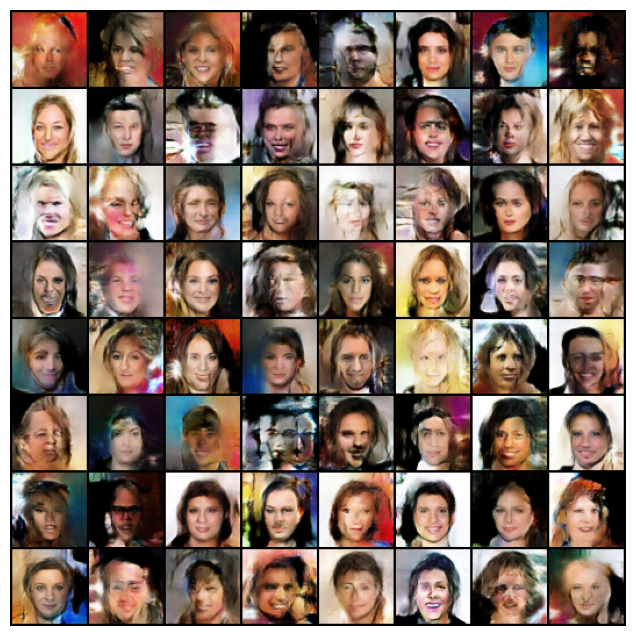

In [28]:
fig = plt.figure(figsize=(8, 8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())
